# Analysis of Different Metropolitian Cities in India

In [5]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library

#!conda install -c conda-forge lxml --yes
#!conda install -c conda-forge html5lib --yes
#!conda install -c conda-forge BeautifulSoup4 --yes
#! conda install -c conda-forge geocoder --yes
print('Libraries imported.')


Libraries imported.


## We determine Latitude and Longitude of India for further Analysis

In [6]:
address = 'India'

geolocator = Nominatim(user_agent="to_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of India are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of India are 22.3511148, 78.6677428.


## Import the Data into Pandas Dataframe

In [7]:
in_cities=pd.read_csv('list_of_cities_and_towns_in_india.csv')
in_cities.head()

,Name of City,State,Population (2011)
0,Mumbai,Maharashtra,"1,35,97,924"
1,Delhi,Delhi,"1,10,07,835"
2,Bengaluru,Karnataka,"84,25,970"
3,Ahmedabad,Gujarat,"72,08,200"
4,Hyderabad,Telangana,"68,09,970"


In [8]:
in_cities.dtypes

Name of City         object
State                object
Population (2011)    object
dtype: object

In [9]:
in_cities['Population (2011)']=in_cities.iloc[:,2].str.replace(",","")
in_cities['State']=in_cities.iloc[:,1].str.replace("Karnatka","Karnataka")
in_cities[['Population (2011)']]=in_cities[['Population (2011)']].astype('int')
in_cities.head()

,Name of City,State,Population (2011)
0,Mumbai,Maharashtra,13597924
1,Delhi,Delhi,11007835
2,Bengaluru,Karnataka,8425970
3,Ahmedabad,Gujarat,7208200
4,Hyderabad,Telangana,6809970


## Lets analyse the population distribution in different cities in India

### We divide data into groups based on states and then plot graph of total Population

                             Population (2011)
State                                         
Andaman and Nicobar Islands              99984
Andhra Pradesh                        11795008
Arunachal Pradesh                        58123
Assam                                  2353662
Bihar                                  8679891


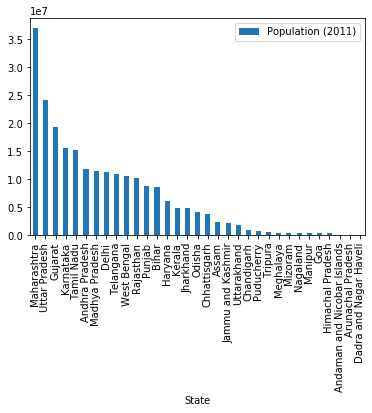

In [10]:
population_data=in_cities.groupby('State',sort=True).sum()
print(population_data.head())
population_data.sort_values(by='Population (2011)',ascending=False).plot(kind="bar")

### We divide data into groups based on states and then plot graph of Mean Population

                             Population (2011)
State                                         
Andaman and Nicobar Islands              99984
Andhra Pradesh                        11795008
Arunachal Pradesh                        58123
Assam                                  2353662
Bihar                                  8679891


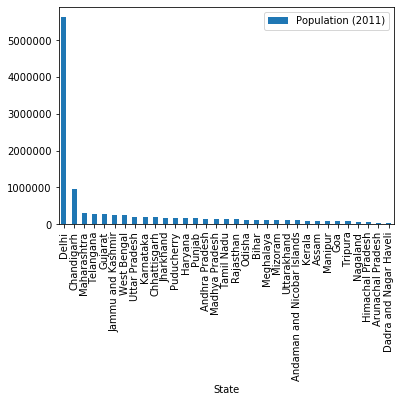

In [11]:
population_data2=in_cities.groupby('State',sort=True).mean()
print(population_data.head())
population_data2.sort_values(by='Population (2011)',ascending=False).plot(kind="bar")

__*We can conclude that though Maharastra has highest population, The most dense city in india is Delhi*__  
It was an interesting finding, lets analyse the data some more

## Let's create Maps for Total as well as Mean population for different States

### First Let's identify Lat and Lon of States

In [12]:
population_data.reset_index(inplace=True)
population_data.head()

,State,Population (2011)
0,Andaman and Nicobar Islands,99984
1,Andhra Pradesh,11795008
2,Arunachal Pradesh,58123
3,Assam,2353662
4,Bihar,8679891


In [13]:
population_data2.reset_index(inplace=True)
population_data2.head()

,State,Population (2011)
0,Andaman and Nicobar Islands,99984.000000
1,Andhra Pradesh,142108.530120
2,Arunachal Pradesh,29061.500000
3,Assam,94146.480000
4,Bihar,123998.442857


In [14]:
import csv
#uncomment this line to find LAT/LONG for now I have put them in csv file
#latlonlist=list() 

In [17]:
#uncomment this line to find LAT/LONG for now i have put them in csv file
"""for state in zip(population_data['State']):
    address = state[0]+", India"
    geolocator = Nominatim(user_agent="st_explorer")
    location = geolocator.geocode(address)
    if location is not None:
        latitudest = location.latitude
        longitudest = location.longitude
    else:
        latitudest=None
        longitudest=None
    print('The geograpical coordinate of {} are {}, {}.'.format(address,latitudest, longitudest))
    latlonlist.append([latitudest,longitudest])"""
with open('lat_long_states.csv', 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['Latitude','Longitude'])
    writer.writerows(latlonlist)

The geograpical coordinate of Andaman and Nicobar Islands, India are 10.2188344, 92.5771329.
The geograpical coordinate of Andhra Pradesh, India are 15.9240905, 80.1863809.
The geograpical coordinate of Arunachal Pradesh, India are 27.6891712, 96.4597226.
The geograpical coordinate of Assam, India are 26.4073841, 93.2551303.
The geograpical coordinate of Bihar, India are 25.6440845, 85.906508.
The geograpical coordinate of Chandigarh, India are 30.7194022, 76.7646552.
The geograpical coordinate of Chhattisgarh, India are 21.6637359, 81.8406351.
The geograpical coordinate of Dadra and Nagar Haveli, India are 20.2735169, 73.0043578.
The geograpical coordinate of Delhi, India are 28.6517178, 77.2219388.
The geograpical coordinate of Goa, India are 15.3004543, 74.0855134.
The geograpical coordinate of Gujarat, India are 22.41540825, 72.03149703699282.
The geograpical coordinate of Haryana, India are 29.0, 76.0.
The geograpical coordinate of Himachal Pradesh, India are 31.81676015, 77.34932

### For Total Population:

In [15]:
latlonstates=pd.read_csv('lat_long_states.csv')
latlonstates.head()

,Latitude,Longitude
0,10.218834,92.577133
1,15.924091,80.186381
2,27.689171,96.459723
3,26.407384,93.255130
4,25.644085,85.906508


In [21]:
tot_map = folium.Map(location=[latitude,longitude], zoom_start=4, tiles='Mapbox Bright')
ind_geo= r'india_states.json'
threshold_scale = np.linspace(population_data['Population (2011)'].min(),
                              population_data['Population (2011)'].max(),
                              6, dtype=int)
threshold_scale = threshold_scale.tolist() # change the numpy array to a list
threshold_scale[-1] = threshold_scale[-1] + 1 # make sure that the last value of the list is greater than the maximum Population
tot_map.choropleth(geo_data=ind_geo,data=population_data,columns=['State','Population (2011)'],
                  key_on='feature.properties.NAME_1',
                   threshold_scale=threshold_scale,
                  legend_name='Total Population Distribution in india',
                  reset=True,
                  fill_color='YlOrRd', 
                    fill_opacity=0.7, 
                    line_opacity=0.2,)
for lat, lon, State in zip(latlonstates['Latitude'], latlonstates['Longitude'], population_data['State']):
    #print(str(lat)+str(poi)+str(cluster)+namesc[cluster])
    label = folium.Popup(str(State), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=1.5,
        popup=label,
        color='blue',
        fill=False,
        fill_color='blue',
        fill_opacity=0.7).add_to(tot_map)
folium.LayerControl().add_to(tot_map)
tot_map

### For Mean Population

In [22]:
tot_map = folium.Map(location=[latitude,longitude], zoom_start=4, tiles='Mapbox Bright')
threshold_scale = np.linspace(population_data2['Population (2011)'].min(),
                              population_data2['Population (2011)'].max(),
                              6, dtype=int)
threshold_scale = threshold_scale.tolist() # change the numpy array to a list
threshold_scale[-1] = threshold_scale[-1] + 1 # make sure that the last value of the list is greater than the maximum Population
tot_map.choropleth(geo_data=ind_geo,data=population_data2,columns=['State','Population (2011)'],
                  key_on='feature.properties.NAME_1',
                   threshold_scale=threshold_scale,
                  legend_name='Total Population Distribution in india',
                  reset=True,
                  fill_color='YlOrRd', 
                    fill_opacity=0.7, 
                    line_opacity=0.2,)
for lat, lon, State in zip(latlonstates['Latitude'], latlonstates['Longitude'], population_data2['State']):
    #print(str(lat)+str(poi)+str(cluster)+namesc[cluster])
    label = folium.Popup(str(State), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=1.5,
        popup=label,
        color='blue',
        fill=False,
        fill_color='blue',
        fill_opacity=0.7).add_to(tot_map)
folium.LayerControl().add_to(tot_map)
tot_map

## Let's Analyse Further using Foursquare API and identify Similar Cities across india

### Latitude and Longitude of different cities

In [16]:
columns=["Latitude","Longitude"]
in_cities=pd.concat([in_cities,pd.DataFrame(columns=columns)])
in_cities.head()

,Name of City,State,Population (2011),Latitude,Longitude
0,Mumbai,Maharashtra,13597924.0,NaN,NaN
1,Delhi,Delhi,11007835.0,NaN,NaN
2,Bengaluru,Karnataka,8425970.0,NaN,NaN
3,Ahmedabad,Gujarat,7208200.0,NaN,NaN
4,Hyderabad,Telangana,6809970.0,NaN,NaN


In [191]:
import csv
#uncomment this line to find LAT/LONG for now i have put them in csv file
#rowlist=list() 

In [192]:
#uncomment this line to find LAT/LONG for now i have put them in csv file
"""for city,state in zip(in_cities['Name of City'],in_cities['State']):
    address = city+', '+state+", India"
    geolocator = Nominatim(user_agent="to_explorer")
    location = geolocator.geocode(address)
    if location is not None:
        latitudec = location.latitude
        longitudec = location.longitude
    else:
        latitudec=None
        longitudec=None
    print('The geograpical coordinate of {} are {}, {}.'.format(address,latitudec, longitudec))
    rowlist.append([latitudec,longitudec])"""
with open('lat_long_cities.csv', 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['Latitude','Longitude'])
    writer.writerows(rowlist)

The geograpical coordinate of Mumbai, Maharashtra, India are 18.9387711, 72.8353355.
The geograpical coordinate of Delhi, Delhi, India are 28.6517178, 77.2219388.
The geograpical coordinate of Bengaluru, Karnataka, India are 12.9791198, 77.5912997.
The geograpical coordinate of Ahmedabad, Gujarat, India are 23.0216238, 72.5797068.
The geograpical coordinate of Hyderabad, Telangana, India are 17.38878595, 78.46106473453146.
The geograpical coordinate of Chennai, Tamil Nadu, India are 13.0801721, 80.2838331.
The geograpical coordinate of Kolkata, West Bengal, India are 22.54541245, 88.3567751581234.
The geograpical coordinate of Pune, Maharashtra, India are 18.521428, 73.8544541.
The geograpical coordinate of Jaipur, Rajasthan, India are 26.916194, 75.820349.
The geograpical coordinate of Surat, Gujarat, India are 21.1864607, 72.8081281.
The geograpical coordinate of Lucknow, Uttar Pradesh, India are 26.8381, 80.9346001.
The geograpical coordinate of Kanpur, Uttar Pradesh, India are 26.4

In [17]:
lat_long=pd.read_csv('lat_long_cities.csv')
lat_long.head()

,Latitude,Longitude
0,18.938771,72.835335
1,28.651718,77.221939
2,12.979120,77.591300
3,23.021624,72.579707
4,17.388786,78.461065


### Append the Co-ordinates to Original Datafrme

In [18]:
incities2=in_cities
print(incities2.shape)
incities2['Latitude']=lat_long['Latitude']
incities2['Longitude']=lat_long['Longitude']
incities2.dropna(subset=["Latitude"],inplace=True)
incities2.shape

(1215, 5)


(1150, 5)

In [19]:
print(incities2.dtypes)
incities2.head()

Name of City          object
State                 object
Population (2011)    float64
Latitude             float64
Longitude            float64
dtype: object


,Name of City,State,Population (2011),Latitude,Longitude
0,Mumbai,Maharashtra,13597924.0,18.938771,72.835335
1,Delhi,Delhi,11007835.0,28.651718,77.221939
2,Bengaluru,Karnataka,8425970.0,12.979120,77.591300
3,Ahmedabad,Gujarat,7208200.0,23.021624,72.579707
4,Hyderabad,Telangana,6809970.0,17.388786,78.461065


### Let's Define Foursquare Creds

In [20]:
#CLIENT_ID1 = 'VYYW0IF3V450J0KRUQS5PFE25ZOXM2CMEVOXCDITIQP2LLYN'#'ZO4QY0P0RAH4CMHYEAE20ACVK1JXHSRMRJDOBJKTTAP5BDK4'#'T1LUMOHYFVR21KSZSVKTKIFO1DPONRPOL4PGKBLWSYTPNDNV' #'J0TY4SIREXQVMUWG15ZQHJBVNVHOXB0VK5CFH2JX4GEUI1JP' # your Foursquare ID
#CLIENT_SECRET1 = 'SJFDANNXKA3R5RNWQQUSFEOMBJKADJ0OQ3V1SJ0WOKSOA3OQ'#'CNB0GLBLRBEI5JGLWGCRSJB3TYDJ3EAVR2N33ECPA4YOT3UR'#'JBKZMRN5WS2PBXLZDUMMLCYJIDZELUNSSP3QKM51GSHXXWB0'#'0RU3G2UPVNACO4TS0505EUMMKMRTQACT4J2XEPFB543AO41L' # your Foursquare Secret
CLIENT_ID2 = 'ZO4QY0P0RAH4CMHYEAE20ACVK1JXHSRMRJDOBJKTTAP5BDK4'#'T1LUMOHYFVR21KSZSVKTKIFO1DPONRPOL4PGKBLWSYTPNDNV' #'J0TY4SIREXQVMUWG15ZQHJBVNVHOXB0VK5CFH2JX4GEUI1JP' # your Foursquare ID
CLIENT_SECRET2 = 'CNB0GLBLRBEI5JGLWGCRSJB3TYDJ3EAVR2N33ECPA4YOT3UR'#'JBKZMRN5WS2PBXLZDUMMLCYJIDZELUNSSP3QKM51GSHXXWB0'#'0RU3G2UPVNACO4TS0505EUMMKMRTQACT4J2XEPFB543AO41L' # your Foursquare Secret
CLIENT_ID3 = 'T1LUMOHYFVR21KSZSVKTKIFO1DPONRPOL4PGKBLWSYTPNDNV' #'J0TY4SIREXQVMUWG15ZQHJBVNVHOXB0VK5CFH2JX4GEUI1JP' # your Foursquare ID
CLIENT_SECRET3 = 'JBKZMRN5WS2PBXLZDUMMLCYJIDZELUNSSP3QKM51GSHXXWB0'#'0RU3G2UPVNACO4TS0505EUMMKMRTQACT4J2XEPFB543AO41L' # your Foursquare Secret
CLIENT_ID1 = 'J0TY4SIREXQVMUWG15ZQHJBVNVHOXB0VK5CFH2JX4GEUI1JP' # your Foursquare ID
CLIENT_SECRET1 ='0RU3G2UPVNACO4TS0505EUMMKMRTQACT4J2XEPFB543AO41L' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version
LIMIT=50
print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID1)
print('CLIENT_SECRET:' + CLIENT_SECRET1)


Your credentails:
CLIENT_ID: J0TY4SIREXQVMUWG15ZQHJBVNVHOXB0VK5CFH2JX4GEUI1JP
CLIENT_SECRET:0RU3G2UPVNACO4TS0505EUMMKMRTQACT4J2XEPFB543AO41L


### Let's define function to determine different venues at different cities

In [21]:
def getNearbyVenues(cid,secret,cities,states,latitudes, longitudes, radius=10000):
    
    CLIENT_ID=cid
    CLIENT_SECRET=secret
    venues_list=[]
    for city,state, lat, lng in zip(cities,states, latitudes, longitudes):
        print(city+","+state)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        try:
            resultsd = requests.get(url).json()
            results=resultsd["response"]['groups'][0]['items']
            #print(str(resultsd))
            # return only relevant information for each nearby venue
            venues_list.append([(
                city,
                state,
                lat, 
                lng, 
                v['venue']['name'], 
                v['venue']['location']['lat'], 
                v['venue']['location']['lng'],  
                v['venue']['categories'][0]['name']) for v in results])
        except:
            print("No venues: "+str(resultsd))

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    
    
    return(nearby_venues)

### We will now Find Venue Lists across All cities

In [22]:
cities_venues = getNearbyVenues(cid=CLIENT_ID1,secret=CLIENT_SECRET1,cities=incities2['Name of City'][0:384],
                                states=incities2['State'][0:384],
                                   latitudes=incities2['Latitude'][0:384],
                                   longitudes=incities2['Longitude'][0:384]
                                  )

"""cities_venues = getNearbyVenues(cid=CLIENT_ID1,secret=CLIENT_SECRET1,cities=incities2['Name of City'][0:1],
                                states=incities2['State'][0:1],
                                   latitudes=incities2['Latitude'][0:1],
                                   longitudes=incities2['Longitude'][0:1]
                                  )"""

Mumbai,Maharashtra
Delhi,Delhi
Bengaluru,Karnataka
Ahmedabad,Gujarat
Hyderabad,Telangana
Chennai,Tamil Nadu
Kolkata,West Bengal
Pune,Maharashtra
Jaipur,Rajasthan
Surat,Gujarat
Lucknow,Uttar Pradesh
Kanpur,Uttar Pradesh
Nagpur,Maharashtra
Patna,Bihar
Indore,Madhya Pradesh
Thane,Maharashtra
Bhopal,Madhya Pradesh
Visakhapatnam,Andhra Pradesh
Vadodara,Gujarat
Firozabad,Uttar Pradesh
Ludhiana,Punjab
Rajkot,Gujarat
Agra,Uttar Pradesh
Siliguri,West Bengal
Nashik,Maharashtra
Faridabad,Haryana
Patiala,Punjab
Meerut,Uttar Pradesh
Kalyan-Dombivali,Maharashtra
Vasai-Virar,Maharashtra
Varanasi,Uttar Pradesh
Srinagar,Jammu and Kashmir
Dhanbad,Jharkhand
Jodhpur,Rajasthan
Amritsar,Punjab
Raipur,Chhattisgarh
Allahabad,Uttar Pradesh
Coimbatore,Tamil Nadu
Jabalpur,Madhya Pradesh
Gwalior,Madhya Pradesh
Vijayawada,Andhra Pradesh
Madurai,Tamil Nadu
Guwahati,Assam
Chandigarh,Chandigarh
Hubli-Dharwad,Karnataka
Amroha,Uttar Pradesh
Moradabad,Uttar Pradesh
Gurgaon,Haryana
Aligarh,Uttar Pradesh
Solapur,Maharasht

"cities_venues = getNearbyVenues(cid=CLIENT_ID1,secret=CLIENT_SECRET1,cities=incities2['Name of City'][0:1],\n                                states=incities2['State'][0:1],\n                                   latitudes=incities2['Latitude'][0:1],\n                                   longitudes=incities2['Longitude'][0:1]\n                                  )"

In [23]:
cities_venues2 = getNearbyVenues(cid=CLIENT_ID2,secret=CLIENT_SECRET2,cities=incities2['Name of City'][384:768],
                                states=incities2['State'][384:768],
                                   latitudes=incities2['Latitude'][384:768],
                                   longitudes=incities2['Longitude'][384:768]
                                  )

Rajpura,Punjab
Kavali,Andhra Pradesh
Dhamtari,Chhattisgarh
Ashok Nagar,Madhya Pradesh
Sardarshahar,Rajasthan
Mahuva,Gujarat
Bargarh,Odisha
Kamareddy,Telangana
Sahibganj,Jharkhand
Kothagudem,Telangana
Ramanagaram,Karnataka
Gokak,Karnataka
Tikamgarh,Madhya Pradesh
Araria,Bihar
Rishikesh,Uttarakhand
Shahdol,Madhya Pradesh
Medininagar (Daltonganj),Jharkhand
Arakkonam,Tamil Nadu
Washim,Maharashtra
Sangrur,Punjab
Bodhan,Telangana
Fazilka,Punjab
Palacole,Andhra Pradesh
Keshod,Gujarat
Sullurpeta,Andhra Pradesh
Wadhwan,Gujarat
Gurdaspur,Punjab
Vatakara,Kerala
Tura,Meghalaya
Narnaul,Haryana
Kharar,Punjab
Yadgir,Karnataka
Ambejogai,Maharashtra
Ankleshwar,Gujarat
Savarkundla,Gujarat
Paradip,Odisha
Virudhachalam,Tamil Nadu
Kanhangad,Kerala
Kadi,Gujarat
Srivilliputhur,Tamil Nadu
Gobindgarh,Punjab
Tindivanam,Tamil Nadu
Mansa,Punjab
Taliparamba,Kerala
Manmad,Maharashtra
Tanuku,Andhra Pradesh
Rayachoti,Andhra Pradesh
Virudhunagar,Tamil Nadu
Koyilandy,Kerala
Jorhat,Assam
Karur,Tamil Nadu
Valparai,Tamil 

In [24]:
cities_venues3 = getNearbyVenues(cid=CLIENT_ID3,secret=CLIENT_SECRET3,cities=incities2['Name of City'][768:1150],
                                states=incities2['State'][768:1150],
                                   latitudes=incities2['Latitude'][768:1150],
                                   longitudes=incities2['Longitude'][768:1150]
                                  )

Naharlagun,Arunachal Pradesh
Pakaur,Jharkhand
Wai,Maharashtra
Tarikere,Karnataka
Malavalli,Karnataka
Raisen,Madhya Pradesh
Lahar,Madhya Pradesh
Uravakonda,Andhra Pradesh
Savanur,Karnataka
Sirohi,Rajasthan
Udhampur,Jammu and Kashmir
Umarga,Maharashtra
Pratapgarh,Rajasthan
Lingsugur,Karnataka
Usilampatti,Tamil Nadu
Palia Kalan,Uttar Pradesh
Wokha,Nagaland
Rajpipla,Gujarat
Vijayapura,Karnataka
Rawatbhata,Rajasthan
Sangaria,Rajasthan
Paithan,Maharashtra
Rahuri,Maharashtra
Patti,Punjab
Zaidpur,Uttar Pradesh
Lalsot,Rajasthan
Maihar,Madhya Pradesh
Vedaranyam,Tamil Nadu
Nawapur,Maharashtra
Solan,Himachal Pradesh
Vapi,Gujarat
Sanawad,Madhya Pradesh
Warisaliganj,Bihar
Revelganj,Bihar
Sabalgarh,Madhya Pradesh
Tuljapur,Maharashtra
Simdega,Jharkhand
Musabani,Jharkhand
Kodungallur,Kerala
Phulabani,Odisha
Umreth,Gujarat
Narsipatnam,Andhra Pradesh
Nautanwa,Uttar Pradesh
Rajgir,Bihar
Yellandu,Telangana
Sathyamangalam,Tamil Nadu
Pilibanga,Rajasthan
Morshi,Maharashtra
Pehowa,Haryana
Sonepur,Bihar
Pappini

In [26]:
print(cities_venues.head())
print(cities_venues2.head())
print(cities_venues3.head())

        0            1          2          3                 4          5  \
0  Mumbai  Maharashtra  18.938771  72.835335   Britannia & Co.  18.934683   
1  Mumbai  Maharashtra  18.938771  72.835335  Food for Thought  18.932031   
2  Mumbai  Maharashtra  18.938771  72.835335         Starbucks  18.932190   
3  Mumbai  Maharashtra  18.938771  72.835335      Marine Drive  18.941221   
4  Mumbai  Maharashtra  18.938771  72.835335       Royal China  18.938715   

           6                   7  
0  72.840183    Parsi Restaurant  
1  72.831667                Café  
2  72.833959         Coffee Shop  
3  72.823261      Scenic Lookout  
4  72.832933  Chinese Restaurant  
         0               1          2          3                4          5  \
0  Rajpura          Punjab  30.477686  76.593766  Cafe Coffee Day  30.486226   
1  Rajpura          Punjab  30.477686  76.593766           Subway  30.524383   
2  Rajpura          Punjab  30.477686  76.593766      Eagle Motel  30.486326   
3  Rajp

In [27]:
print(cities_venues.shape)
print(cities_venues2.shape)
print(cities_venues3.shape)

(4438, 8)
(1640, 8)
(1535, 8)


In [29]:
frames=[cities_venues,cities_venues2,cities_venues3]
cities_venuesd=pd.concat(frames)
cities_venues=cities_venuesd
cities_venues.shape

(7613, 8)

In [30]:
cities_venues.columns = ['City','State',
                  'City Latitude', 
                  'City Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']

In [37]:
cities_venues.head()

,City,State,City Latitude,City Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Mumbai,Maharashtra,18.938771,72.835335,Britannia & Co.,18.934683,72.840183,Parsi Restaurant
1,Mumbai,Maharashtra,18.938771,72.835335,Food for Thought,18.932031,72.831667,Café
2,Mumbai,Maharashtra,18.938771,72.835335,Starbucks,18.932190,72.833959,Coffee Shop
3,Mumbai,Maharashtra,18.938771,72.835335,Marine Drive,18.941221,72.823261,Scenic Lookout
4,Mumbai,Maharashtra,18.938771,72.835335,Royal China,18.938715,72.832933,Chinese Restaurant


In [38]:
cities_venues.groupby('City').count().sort_values(by='State',ascending=False).head()

,State,City Latitude,City Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
City,,,,,,,
Vapi,54,54,54,54,54,54,54
Udaipur,52,52,52,52,52,52,52
Zirakpur,50,50,50,50,50,50,50
Lucknow,50,50,50,50,50,50,50
Nagpur,50,50,50,50,50,50,50


In [39]:
cities_venues.groupby('State').count().sort_values(by='State',ascending=False).head()

,City,City Latitude,City Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
State,,,,,,,
West Bengal,226,226,226,226,226,226,226
Uttarakhand,172,172,172,172,172,172,172
Uttar Pradesh,513,513,513,513,513,513,513
Tripura,9,9,9,9,9,9,9
Telangana,190,190,190,190,190,190,190


#### Let's find out how many unique categories can be curated from all the returned venues

In [40]:
print('There are {} uniques categories.'.format(len(cities_venues['Venue Category'].unique())))

There are 318 uniques categories.


<a id='item3'></a>

### Analyze Each City

In [41]:
# one hot encoding
cities_onehot = pd.get_dummies(cities_venues[['Venue Category']], prefix="", prefix_sep="")

# add City column back to dataframe
cities_onehot['City'] = cities_venues['City'] 

# move City column to the first column
fixed_columns = [cities_onehot.columns[-1]] + list(cities_onehot.columns[:-1])
cities_onehot = cities_onehot[fixed_columns]

cities_onehot.head()

,Zoo,ATM,Accessories Store,Adult Boutique,Afghan Restaurant,Airport,Airport Food Court,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Andhra Restaurant,Antique Shop,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Astrologer,Athletics & Sports,Australian Restaurant,Auto Dealership,Auto Garage,Awadhi Restaurant,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Basketball Court,Bay,Beach,Beach Bar,Bed & Breakfast,Beer Garden,Bengali Restaurant,Big Box Store,Bike Rental / Bike Share,Bike Trail,Bistro,Boarding House,Boat or Ferry,Bookstore,Border Crossing,Boutique,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Cable Car,Cafeteria,Café,Campground,Canal,Candy Store,Caribbean Restaurant,Casino,Castle,Cave,Chaat Place,Chinese Restaurant,Chocolate Shop,Circus,City,Clothing Store,Cocktail Bar,Coffee Shop,College Cafeteria,Comedy Club,Comfort Food Restaurant,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Cricket Ground,Cruise,Cuban Restaurant,Cupcake Shop,Currency Exchange,Dairy Store,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dhaba,Diner,Doctor's Office,Donut Shop,Eastern European Restaurant,Electronics Store,Event Space,Exhibit,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Fireworks Store,Fish & Chips Shop,Flea Market,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,Football Stadium,Forest,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gastropub,General College & University,General Entertainment,General Travel,Gift Shop,Gluten-free Restaurant,Go Kart Track,Goan Restaurant,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Harbor / Marina,Health & Beauty Service,Herbs & Spices Store,Hindu Temple,Historic Site,History Museum,Home Service,Hookah Bar,Hostel,Hot Spring,Hotel,Hotel Bar,Hotel Pool,Hyderabadi Restaurant,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indian Sweet Shop,Indie Movie Theater,Indonesian Restaurant,Insurance Office,Intersection,Irani Cafe,Irish Pub,Island,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karnataka Restaurant,Kebab Restaurant,Kerala Restaurant,Korean Restaurant,Lake,Lawyer,Light Rail Station,Lighthouse,Lingerie Store,Liquor Store,Lounge,Maharashtrian Restaurant,Malay Restaurant,Manadonese Restaurant,Market,Mattress Store,Medical Supply Store,Mediterranean Restaurant,Memorial Site,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Motel,Motorcycle Shop,Mountain,Movie Theater,Moving Target,Mughlai Restaurant,Multicuisine Indian Restaurant,Multiplex,Museum,Music Store,Music Venue,National Park,Nature Preserve,Neighborhood,Night Market,Nightclub,North Indian Restaurant,Northeast Indian Restaurant,Optical Shop,Organic Grocery,Other Great Outdoors,Other Nightlife,Outdoor Sculpture,Outdoors & Recreation,Outlet Store,Palace,Park,Parsi Restaurant,Performing Arts Venue,Persian Restaurant,Pharmacy,Photography Studio,Pier,Pizza Place,Planetarium,Platform,Playground,Plaza,Pool,Portuguese Restaurant,Print Shop,Pub,Punjabi Restaurant,Racetrack,Rajasthani Restaurant,Recreation Center,Rental Car Location,Reservoir,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,River,Road,Roof Deck,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,Science Museum,Sculpture Garden,Seafood Restaurant,Shipping Store,Shoe Repair,Shop & Service,Shopping Mall,Shopping Plaza,Shrine,Sikh Temple,Skate Park,Ski Area,Smoke Shop,Snack Place,Soccer Field,South American Restaurant,South Indian Restaurant,Southern / Soul Food Restaurant,Spa,Spanish Restaurant,Speakeasy,Spiritual Center,Sporting Goods Shop,Sports Bar,S

And let's examine the new dataframe size.

In [42]:
cities_onehot.shape

(7613, 318)

#### Next, let's group rows by City and by taking the mean of the frequency of occurrence of each category

In [43]:
cities_grouped = cities_onehot.groupby('City').mean().reset_index()
cities_grouped.head()

,City,Zoo,ATM,Accessories Store,Adult Boutique,Afghan Restaurant,Airport,Airport Food Court,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Andhra Restaurant,Antique Shop,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Astrologer,Athletics & Sports,Australian Restaurant,Auto Dealership,Auto Garage,Awadhi Restaurant,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Basketball Court,Bay,Beach,Beach Bar,Bed & Breakfast,Beer Garden,Bengali Restaurant,Big Box Store,Bike Rental / Bike Share,Bike Trail,Bistro,Boarding House,Boat or Ferry,Bookstore,Border Crossing,Boutique,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Cable Car,Cafeteria,Café,Campground,Canal,Candy Store,Caribbean Restaurant,Casino,Castle,Cave,Chaat Place,Chinese Restaurant,Chocolate Shop,Circus,Clothing Store,Cocktail Bar,Coffee Shop,College Cafeteria,Comedy Club,Comfort Food Restaurant,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Cricket Ground,Cruise,Cuban Restaurant,Cupcake Shop,Currency Exchange,Dairy Store,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dhaba,Diner,Doctor's Office,Donut Shop,Eastern European Restaurant,Electronics Store,Event Space,Exhibit,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Fireworks Store,Fish & Chips Shop,Flea Market,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,Football Stadium,Forest,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gastropub,General College & University,General Entertainment,General Travel,Gift Shop,Gluten-free Restaurant,Go Kart Track,Goan Restaurant,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Harbor / Marina,Health & Beauty Service,Herbs & Spices Store,Hindu Temple,Historic Site,History Museum,Home Service,Hookah Bar,Hostel,Hot Spring,Hotel,Hotel Bar,Hotel Pool,Hyderabadi Restaurant,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indian Sweet Shop,Indie Movie Theater,Indonesian Restaurant,Insurance Office,Intersection,Irani Cafe,Irish Pub,Island,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karnataka Restaurant,Kebab Restaurant,Kerala Restaurant,Korean Restaurant,Lake,Lawyer,Light Rail Station,Lighthouse,Lingerie Store,Liquor Store,Lounge,Maharashtrian Restaurant,Malay Restaurant,Manadonese Restaurant,Market,Mattress Store,Medical Supply Store,Mediterranean Restaurant,Memorial Site,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Motel,Motorcycle Shop,Mountain,Movie Theater,Moving Target,Mughlai Restaurant,Multicuisine Indian Restaurant,Multiplex,Museum,Music Store,Music Venue,National Park,Nature Preserve,Neighborhood,Night Market,Nightclub,North Indian Restaurant,Northeast Indian Restaurant,Optical Shop,Organic Grocery,Other Great Outdoors,Other Nightlife,Outdoor Sculpture,Outdoors & Recreation,Outlet Store,Palace,Park,Parsi Restaurant,Performing Arts Venue,Persian Restaurant,Pharmacy,Photography Studio,Pier,Pizza Place,Planetarium,Platform,Playground,Plaza,Pool,Portuguese Restaurant,Print Shop,Pub,Punjabi Restaurant,Racetrack,Rajasthani Restaurant,Recreation Center,Rental Car Location,Reservoir,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,River,Road,Roof Deck,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,Science Museum,Sculpture Garden,Seafood Restaurant,Shipping Store,Shoe Repair,Shop & Service,Shopping Mall,Shopping Plaza,Shrine,Sikh Temple,Skate Park,Ski Area,Smoke Shop,Snack Place,Soccer Field,South American Restaurant,South Indian Restaurant,Southern / Soul Food Restaurant,Spa,Spanish Restaurant,Speakeasy,Spiritual Center,Sporting Goods Shop,Sports Bar,S

#### Let's confirm the new size

In [44]:
cities_grouped.shape

(1013, 318)

#### Let's print some of Cities along with the top 5 most common venues

In [45]:
num_top_venues = 5

for hood in cities_grouped['City'][0:200]:
    print("----"+hood+"----")
    temp = cities_grouped[cities_grouped['City'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Achalpur----
               venue  freq
0                ATM  0.25
1  Mobile Phone Shop  0.25
2        Art Gallery  0.25
3        Snack Place  0.25
4       Neighborhood  0.00


----Achhnera----
                venue  freq
0                 ATM  0.25
1  Mughlai Restaurant  0.12
2   Indian Restaurant  0.12
3     Border Crossing  0.12
4            Platform  0.12


----Adalaj----
               venue  freq
0  Indian Restaurant  0.23
1               Café  0.09
2        Pizza Place  0.07
3     Sandwich Place  0.07
4          Multiplex  0.07


----Adilabad----
             venue  freq
0         Pharmacy   0.5
1             Food   0.5
2              Zoo   0.0
3  Organic Grocery   0.0
4     Optical Shop   0.0


----Adityapur----
                venue  freq
0               Hotel  0.27
1                Café  0.13
2              Market  0.07
3           Multiplex  0.07
4  Italian Restaurant  0.07


----Adoni----
               venue  freq
0   Department Store  0.25
1    Motorcycle Shop  0.25
2

In [47]:
cities_grouped.head()

,City,Zoo,ATM,Accessories Store,Adult Boutique,Afghan Restaurant,Airport,Airport Food Court,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Andhra Restaurant,Antique Shop,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Astrologer,Athletics & Sports,Australian Restaurant,Auto Dealership,Auto Garage,Awadhi Restaurant,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Basketball Court,Bay,Beach,Beach Bar,Bed & Breakfast,Beer Garden,Bengali Restaurant,Big Box Store,Bike Rental / Bike Share,Bike Trail,Bistro,Boarding House,Boat or Ferry,Bookstore,Border Crossing,Boutique,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Cable Car,Cafeteria,Café,Campground,Canal,Candy Store,Caribbean Restaurant,Casino,Castle,Cave,Chaat Place,Chinese Restaurant,Chocolate Shop,Circus,Clothing Store,Cocktail Bar,Coffee Shop,College Cafeteria,Comedy Club,Comfort Food Restaurant,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Cricket Ground,Cruise,Cuban Restaurant,Cupcake Shop,Currency Exchange,Dairy Store,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dhaba,Diner,Doctor's Office,Donut Shop,Eastern European Restaurant,Electronics Store,Event Space,Exhibit,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Fireworks Store,Fish & Chips Shop,Flea Market,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,Football Stadium,Forest,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gastropub,General College & University,General Entertainment,General Travel,Gift Shop,Gluten-free Restaurant,Go Kart Track,Goan Restaurant,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Harbor / Marina,Health & Beauty Service,Herbs & Spices Store,Hindu Temple,Historic Site,History Museum,Home Service,Hookah Bar,Hostel,Hot Spring,Hotel,Hotel Bar,Hotel Pool,Hyderabadi Restaurant,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indian Sweet Shop,Indie Movie Theater,Indonesian Restaurant,Insurance Office,Intersection,Irani Cafe,Irish Pub,Island,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karnataka Restaurant,Kebab Restaurant,Kerala Restaurant,Korean Restaurant,Lake,Lawyer,Light Rail Station,Lighthouse,Lingerie Store,Liquor Store,Lounge,Maharashtrian Restaurant,Malay Restaurant,Manadonese Restaurant,Market,Mattress Store,Medical Supply Store,Mediterranean Restaurant,Memorial Site,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Motel,Motorcycle Shop,Mountain,Movie Theater,Moving Target,Mughlai Restaurant,Multicuisine Indian Restaurant,Multiplex,Museum,Music Store,Music Venue,National Park,Nature Preserve,Neighborhood,Night Market,Nightclub,North Indian Restaurant,Northeast Indian Restaurant,Optical Shop,Organic Grocery,Other Great Outdoors,Other Nightlife,Outdoor Sculpture,Outdoors & Recreation,Outlet Store,Palace,Park,Parsi Restaurant,Performing Arts Venue,Persian Restaurant,Pharmacy,Photography Studio,Pier,Pizza Place,Planetarium,Platform,Playground,Plaza,Pool,Portuguese Restaurant,Print Shop,Pub,Punjabi Restaurant,Racetrack,Rajasthani Restaurant,Recreation Center,Rental Car Location,Reservoir,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,River,Road,Roof Deck,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,Science Museum,Sculpture Garden,Seafood Restaurant,Shipping Store,Shoe Repair,Shop & Service,Shopping Mall,Shopping Plaza,Shrine,Sikh Temple,Skate Park,Ski Area,Smoke Shop,Snack Place,Soccer Field,South American Restaurant,South Indian Restaurant,Southern / Soul Food Restaurant,Spa,Spanish Restaurant,Speakeasy,Spiritual Center,Sporting Goods Shop,Sports Bar,S

#### Let's put that into a *pandas* dataframe

let's write a function to sort the venues in descending order.

In [48]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

Now let's create the new dataframe and display the top 10 venues for each City.

In [95]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['City']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
Citys_venues_sorted = pd.DataFrame(columns=columns)
Citys_venues_sorted['City'] = cities_grouped['City']

for ind in np.arange(cities_grouped.shape[0]):
    Citys_venues_sorted.iloc[ind, 1:] = return_most_common_venues(cities_grouped.iloc[ind, :], num_top_venues)

Citys_venues_sorted.head()

,City,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Achalpur,ATM,Mobile Phone Shop,Snack Place,Art Gallery,Women's Store,Fireworks Store,Factory,Falafel Restaurant,Farm,Farmers Market
1,Achhnera,ATM,Toll Booth,Indian Restaurant,Platform,Border Crossing,Mughlai Restaurant,Bed & Breakfast,Fireworks Store,Factory,Falafel Restaurant
2,Adalaj,Indian Restaurant,Café,Restaurant,Multiplex,Sandwich Place,Pizza Place,Coffee Shop,Fast Food Restaurant,Arcade,Chinese Restaurant
3,Adilabad,Pharmacy,Food,Fireworks Store,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field
4,Adityapur,Hotel,Café,Sandwich Place,Indian Restaurant,Ice Cream Shop,Bakery,Pizza Place,Market,Multiplex,Italian Restaurant


### Cluster Citys

#### Lets Run *k*-means to cluster the City into different Clusters and identify best fit via Elbow Method

In [50]:
from scipy.spatial.distance import cdist

cities_grouped_clustering = cities_grouped.drop('City', 1)
distortions = [] 
inertias = [] 
mapping1 = {} 
mapping2 = {} 
K = range(1,12) 
  
for k in K: 
    #Building and fitting the model 
    kmeanModel = KMeans(n_clusters=k, random_state=0).fit(cities_grouped_clustering)     
      
    distortions.append(sum(np.min(cdist(cities_grouped_clustering, kmeanModel.cluster_centers_, 
                      'euclidean'),axis=1)) / cities_grouped_clustering.shape[0]) 
    inertias.append(kmeanModel.inertia_) 
  
    mapping1[k] = sum(np.min(cdist(cities_grouped_clustering, kmeanModel.cluster_centers_, 
                 'euclidean'),axis=1)) / cities_grouped_clustering.shape[0] 
    mapping2[k] = kmeanModel.inertia_ 


Let's create a new dataframe that includes the cluster as well as the top 10 venues for each City.

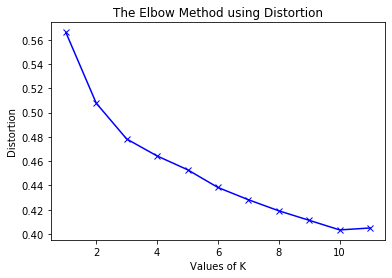

In [51]:
import matplotlib.pyplot as plt
plt.plot(K, distortions, 'bx-') 
plt.xlabel('Values of K') 
plt.ylabel('Distortion') 
plt.title('The Elbow Method using Distortion') 
plt.show()

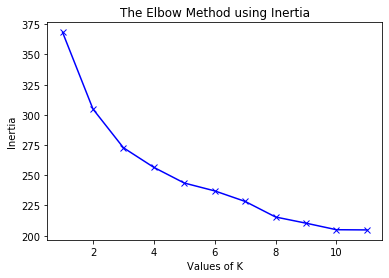

In [52]:
plt.plot(K, inertias, 'bx-') 
plt.xlabel('Values of K') 
plt.ylabel('Inertia') 
plt.title('The Elbow Method using Inertia') 
plt.show() 

## Choosing k  
Although, It is quite continous line,It appears k=5 will give good estimation of data

In [96]:
# set number of clusters
kclusters = 5


# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(cities_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10]

array([0, 0, 4, 0, 0, 4, 0, 2, 0, 1], dtype=int32)

In [97]:
incities2.columns=['City', 
                  'State', 
                  'Population', 
                  'Latitude', 
                  'Longitude']
incities2.sort_values(by='City').head()

,City,State,Population,Latitude,Longitude
292,Achalpur,Maharashtra,112293.0,21.241445,77.425757
1093,Achhnera,Uttar Pradesh,22781.0,27.176058,77.758213
1202,Adalaj,Gujarat,11957.0,23.164692,72.582105
277,Adilabad,Telangana,117167.0,19.500000,78.500000
191,Adityapur,Jharkhand,174355.0,22.782355,86.159003


In [98]:
# add clustering labels
Citys_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

cities_merged = incities2

# merge toronto_grouped with toronto_data to add latitude/longitude for each City
cities_merged = cities_merged.join(Citys_venues_sorted.set_index('City'), on='City')

cities_merged.head() # check the last columns!

,City,State,Population,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Mumbai,Maharashtra,13597924.0,18.938771,72.835335,0.0,Café,Ice Cream Shop,Hotel,Indian Restaurant,Scenic Lookout,Cricket Ground,Pizza Place,Dessert Shop,Fast Food Restaurant,Diner
1,Delhi,Delhi,11007835.0,28.651718,77.221939,4.0,Indian Restaurant,Hotel,Lounge,Café,Monument / Landmark,Bar,South Indian Restaurant,Bakery,Molecular Gastronomy Restaurant,Boutique
2,Bengaluru,Karnataka,8425970.0,12.979120,77.591300,0.0,Hotel,Ice Cream Shop,Park,Bakery,Department Store,Indian Restaurant,Pub,Steakhouse,Brewery,Breakfast Spot
3,Ahmedabad,Gujarat,7208200.0,23.021624,72.579707,0.0,Café,Dessert Shop,Indian Restaurant,Tea Room,Multiplex,Clothing Store,Coffee Shop,History Museum,Snack Place,Fast Food Restaurant
4,Hyderabad,Telangana,6809970.0,17.388786,78.461065,0.0,Indian Restaurant,Bakery,Ice Cream Shop,Hotel,South Indian Restaurant,Chaat Place,Multiplex,Café,Juice Bar,Snack Place


In [99]:
cities_merged.sort_values(by='City').head()

,City,State,Population,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
292,Achalpur,Maharashtra,112293.0,21.241445,77.425757,0.0,ATM,Mobile Phone Shop,Snack Place,Art Gallery,Women's Store,Fireworks Store,Factory,Falafel Restaurant,Farm,Farmers Market
1093,Achhnera,Uttar Pradesh,22781.0,27.176058,77.758213,0.0,ATM,Toll Booth,Indian Restaurant,Platform,Border Crossing,Mughlai Restaurant,Bed & Breakfast,Fireworks Store,Factory,Falafel Restaurant
1202,Adalaj,Gujarat,11957.0,23.164692,72.582105,4.0,Indian Restaurant,Café,Restaurant,Multiplex,Sandwich Place,Pizza Place,Coffee Shop,Fast Food Restaurant,Arcade,Chinese Restaurant
277,Adilabad,Telangana,117167.0,19.500000,78.500000,0.0,Pharmacy,Food,Fireworks Store,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field
191,Adityapur,Jharkhand,174355.0,22.782355,86.159003,0.0,Hotel,Café,Sandwich Place,Indian Restaurant,Ice Cream Shop,Bakery,Pizza Place,Market,Multiplex,Italian Restaurant


In [100]:
print(cities_merged.shape)
cities_merged.dropna(subset=["Cluster Labels"],inplace=True)
cities_merged.reset_index(inplace=True)
cities_merged[['Cluster Labels']]=cities_merged[['Cluster Labels']].astype('int')

(1150, 16)


In [101]:
print(cities_merged.shape)
cities_merged.drop(['index'], axis = 1,inplace=True)
cities_merged.head()

(1029, 17)


,City,State,Population,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Mumbai,Maharashtra,13597924.0,18.938771,72.835335,0,Café,Ice Cream Shop,Hotel,Indian Restaurant,Scenic Lookout,Cricket Ground,Pizza Place,Dessert Shop,Fast Food Restaurant,Diner
1,Delhi,Delhi,11007835.0,28.651718,77.221939,4,Indian Restaurant,Hotel,Lounge,Café,Monument / Landmark,Bar,South Indian Restaurant,Bakery,Molecular Gastronomy Restaurant,Boutique
2,Bengaluru,Karnataka,8425970.0,12.979120,77.591300,0,Hotel,Ice Cream Shop,Park,Bakery,Department Store,Indian Restaurant,Pub,Steakhouse,Brewery,Breakfast Spot
3,Ahmedabad,Gujarat,7208200.0,23.021624,72.579707,0,Café,Dessert Shop,Indian Restaurant,Tea Room,Multiplex,Clothing Store,Coffee Shop,History Museum,Snack Place,Fast Food Restaurant
4,Hyderabad,Telangana,6809970.0,17.388786,78.461065,0,Indian Restaurant,Bakery,Ice Cream Shop,Hotel,South Indian Restaurant,Chaat Place,Multiplex,Café,Juice Bar,Snack Place


Finally, let's visualize the resulting clusters

In [102]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=5)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]
# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(cities_merged['Latitude'], cities_merged['Longitude'], cities_merged['City'], cities_merged['Cluster Labels']):
    #print(str(lat)+str(poi)+str(cluster)+namesc[cluster])
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster],
        fill=True,
        fill_color=rainbow[cluster],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

<a id='item5'></a>

### Let's Examine Clusters

Now, Let's examine each cluster and determine the discriminating venue categories that distinguish each cluster

#### Cluster 1

In [103]:
cities_merged.loc[cities_merged['Cluster Labels'] == 0, cities_merged.columns[[0] + list(range(5, cities_merged.shape[1]))]]

,City,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Mumbai,0,Café,Ice Cream Shop,Hotel,Indian Restaurant,Scenic Lookout,Cricket Ground,Pizza Place,Dessert Shop,Fast Food Restaurant,Diner
2,Bengaluru,0,Hotel,Ice Cream Shop,Park,Bakery,Department Store,Indian Restaurant,Pub,Steakhouse,Brewery,Breakfast Spot
3,Ahmedabad,0,Café,Dessert Shop,Indian Restaurant,Tea Room,Multiplex,Clothing Store,Coffee Shop,History Museum,Snack Place,Fast Food Restaurant
4,Hyderabad,0,Indian Restaurant,Bakery,Ice Cream Shop,Hotel,South Indian Restaurant,Chaat Place,Multiplex,Café,Juice Bar,Snack Place
5,Chennai,0,Indian Restaurant,Italian Restaurant,Juice Bar,Hotel,Bar,Vegetarian / Vegan Restaurant,Café,Multiplex,Park,Gaming Cafe
6,Kolkata,0,Chinese Restaurant,Hotel,Indian Restaurant,Indian Sweet Shop,Mughlai Restaurant,Dhaba,Shopping Mall,Bengali Restaurant,Nightclub,Bookstore
7,Pune,0,Italian Restaurant,Bakery,Snack Place,Lounge,Indian Restaurant,Pub,Coffee Shop,South Indian Restaurant,Fast Food Restaurant,Ice Cream Shop
8,Jaipur,0,Hotel,Indian Restaurant,Historic Site,Café,Ice Cream Shop,Palace,Hostel,Tea Room,Lounge,Garden
9,Surat,0,Indian Restaurant,Restaurant,Fast Food Restaurant,Multiplex,Chinese Restaurant,Tea Room,Café,Pizza Place,Ice Cream Shop,Hotel
10,Lucknow,0,Indian Restaurant,Fast Food Restaurant,Hotel,Shopping Mall,Bakery,Café,Pizza Place,Ice Cream Shop,Multiplex,Market


#### Cluster 2

In [104]:
cities_merged.loc[cities_merged['Cluster Labels'] == 1, cities_merged.columns[[0] + list(range(5, cities_merged.shape[1]))]]

,City,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
77,Jhansi,1,Train Station,Dhaba,Women's Store,Field,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant
90,Akola,1,Mobile Phone Shop,Train Station,Fast Food Restaurant,Women's Store,Fireworks Store,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market
95,Agartala,1,Train Station,Salad Place,Coffee Shop,Men's Store,Women's Store,Field,Fabric Shop,Factory,Falafel Restaurant,Farm
140,Pali,1,Train Station,Indian Restaurant,Salad Place,Women's Store,Fast Food Restaurant,Exhibit,Fabric Shop,Factory,Falafel Restaurant,Farm
143,Katihar,1,Train Station,Indian Restaurant,Shopping Mall,Women's Store,Field,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market
148,Murwara (Katni),1,Train Station,Indian Restaurant,Platform,Field,Exhibit,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market
152,English Bazar,1,Train Station,University,ATM,Indian Restaurant,Fireworks Store,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market
156,Deoghar,1,Train Station,Electronics Store,Ice Cream Shop,Men's Store,Field,Exhibit,Fabric Shop,Factory,Falafel Restaurant,Farm
166,Orai,1,Train Station,ATM,Restaurant,Women's Store,Fast Food Restaurant,Exhibit,Fabric Shop,Factory,Falafel Restaurant,Farm
181,Rae Bareli,1,Asian Restaurant,Train Station,Market,Women's Store,Field,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant


#### Cluster 3

In [105]:
cities_merged.loc[cities_merged['Cluster Labels'] == 2, cities_merged.columns[[0] + list(range(5, cities_merged.shape[1]))]]

,City,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
45,Amroha,2,ATM,Pharmacy,Women's Store,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field
84,Tirunelveli,2,ATM,Airport,Women's Store,Fish & Chips Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field
98,Brahmapur,2,ATM,Indian Restaurant,Hotel,Pizza Place,Shopping Mall,Motorcycle Shop,Train Station,Convenience Store,Hotel Bar,Electronics Store
104,Shahjahanpur,2,ATM,Indian Restaurant,North Indian Restaurant,Food & Drink Shop,Fireworks Store,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant
108,Nizamabad,2,ATM,Currency Exchange,Pharmacy,Women's Store,Fish & Chips Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant
134,Bharatpur,2,ATM,Women's Store,Fish & Chips Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Fireworks Store
135,Begusarai,2,Campground,ATM,Fireworks Store,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field
154,Panchkula,2,ATM,Lake,Women's Store,Fish & Chips Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field
159,Bhiwani,2,ATM,Motorcycle Shop,Food Court,Fireworks Store,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant
164,Baharampur,2,ATM,Pharmacy,Train Station,Hotel,Fireworks Store,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market


#### Cluster 4

In [106]:
cities_merged.loc[cities_merged['Cluster Labels'] == 3, cities_merged.columns[[0] + list(range(5, cities_merged.shape[1]))]]

,City,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
49,Solapur,3,Mobile Phone Shop,Women's Store,Fish & Chips Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Fireworks Store
97,Latur,3,Mobile Phone Shop,Vegetarian / Vegan Restaurant,Women's Store,Fireworks Store,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant
103,Raghunathganj,3,Basketball Court,ATM,Mobile Phone Shop,Women's Store,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Fireworks Store
253,Yavatmal,3,Mobile Phone Shop,Women's Store,Fish & Chips Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Fireworks Store
266,Osmanabad,3,Mobile Phone Shop,ATM,Women's Store,Fish & Chips Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field
319,Akot,3,Mobile Phone Shop,Women's Store,Fish & Chips Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Fireworks Store
467,Wani,3,Furniture / Home Store,Mobile Phone Shop,Women's Store,Fish & Chips Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field
493,Anjangaon,3,Mobile Phone Shop,ATM,Bus Stop,Women's Store,Fish & Chips Shop,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field
577,Umarkhed,3,Mobile Phone Shop,Women's Store,Fish & Chips Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Fireworks Store
584,Warora,3,Mobile Phone Shop,Train Station,Women's Store,Fireworks Store,Fabric Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant


#### Cluster 5

In [107]:
cities_merged.loc[cities_merged['Cluster Labels'] == 4, cities_merged.columns[[0] + list(range(5, cities_merged.shape[1]))]]

,City,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,Delhi,4,Indian Restaurant,Hotel,Lounge,Café,Monument / Landmark,Bar,South Indian Restaurant,Bakery,Molecular Gastronomy Restaurant,Boutique
41,Madurai,4,Indian Restaurant,Hotel,Shopping Mall,Movie Theater,Café,Bakery,Multiplex,Ice Cream Shop,Cupcake Shop,Fried Chicken Joint
52,Tiruchirappalli,4,Indian Restaurant,Multiplex,Ice Cream Shop,Hotel,Train Station,Italian Restaurant,Restaurant,Asian Restaurant,Shopping Mall,Burger Joint
54,Salem,4,Indian Restaurant,Multiplex,Ice Cream Shop,Bakery,Indie Movie Theater,Chinese Restaurant,Southern / Soul Food Restaurant,Shopping Mall,Fast Food Restaurant,Café
58,Bhiwandi,4,Indian Restaurant,Vegetarian / Vegan Restaurant,Hookah Bar,Fast Food Restaurant,Park,Chinese Restaurant,Restaurant,Snack Place,Comfort Food Restaurant,Airport Lounge
88,Davanagere,4,Indian Restaurant,Coffee Shop,Breakfast Spot,Lake,Fast Food Restaurant,Restaurant,Café,Clothing Store,Resort,Pizza Place
91,Kurnool,4,Indian Restaurant,Bus Station,Multiplex,Shopping Mall,Women's Store,Field,Factory,Falafel Restaurant,Farm,Farmers Market
93,Rajahmundry,4,Indian Restaurant,Arcade,Hotel,Motel,Multiplex,Department Store,Pizza Place,Café,Train Station,Indie Movie Theater
101,Ahmednagar,4,Indian Restaurant,ATM,Monument / Landmark,Mobile Phone Shop,Fish & Chips Shop,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant
110,Tumkur,4,Indian Restaurant,Toll Plaza,Hotel Bar,Restaurant,Coffee Shop,Café,Pizza Place,Food Court,Event Space,Exhibit


In [108]:
cities_merged.groupby('Cluster Labels')[['1st Most Common Venue','2nd Most Common Venue','3rd Most Common Venue']].describe(include='all')

1st Most Common Venue                                 \
                               count unique                top freq   
Cluster Labels                                                        
0                                547    118  Indian Restaurant   56   
1                                138     25      Train Station   87   
2                                167     11                ATM  151   
3                                 36      6  Mobile Phone Shop   29   
4                                141     13  Indian Restaurant  128   

               2nd Most Common Venue                                 \
                               count unique                top freq   
Cluster Labels                                                        
0                                547    127  Indian Restaurant   44   
1                                138     31      Train Station   43   
2                                167     41      Women's Store   58   
3                                 36     13      Women's Store   12   
4                                141     57                ATM   18   

               3rd Most Common Venue                                 
                               count unique                top freq  
Cluster Labels                                                       
0                                547    117      Women's Store   38  
1                                138     45      Women's Store   34  
2                                167     30  Fish & Chips Shop   70  
3                                 36      7      Women's Store   17  
4                                141     57      Train Station   16

#### From the above results lets Rename Clusters

In [109]:
columnsl=['City', 'State', 'Population', 'Latitude', 'Longitude',
       'Cluster Labels','Cluster Names', '1st Most Common Venue', '2nd Most Common Venue',
       '3rd Most Common Venue', '4th Most Common Venue',
       '5th Most Common Venue', '6th Most Common Venue',
       '7th Most Common Venue', '8th Most Common Venue',
       '9th Most Common Venue', '10th Most Common Venue']
cities_merged = cities_merged.reindex(columns = columnsl)
cities_merged.head()

,City,State,Population,Latitude,Longitude,Cluster Labels,Cluster Names,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Mumbai,Maharashtra,13597924.0,18.938771,72.835335,0,NaN,Café,Ice Cream Shop,Hotel,Indian Restaurant,Scenic Lookout,Cricket Ground,Pizza Place,Dessert Shop,Fast Food Restaurant,Diner
1,Delhi,Delhi,11007835.0,28.651718,77.221939,4,NaN,Indian Restaurant,Hotel,Lounge,Café,Monument / Landmark,Bar,South Indian Restaurant,Bakery,Molecular Gastronomy Restaurant,Boutique
2,Bengaluru,Karnataka,8425970.0,12.979120,77.591300,0,NaN,Hotel,Ice Cream Shop,Park,Bakery,Department Store,Indian Restaurant,Pub,Steakhouse,Brewery,Breakfast Spot
3,Ahmedabad,Gujarat,7208200.0,23.021624,72.579707,0,NaN,Café,Dessert Shop,Indian Restaurant,Tea Room,Multiplex,Clothing Store,Coffee Shop,History Museum,Snack Place,Fast Food Restaurant
4,Hyderabad,Telangana,6809970.0,17.388786,78.461065,0,NaN,Indian Restaurant,Bakery,Ice Cream Shop,Hotel,South Indian Restaurant,Chaat Place,Multiplex,Café,Juice Bar,Snack Place


In [110]:
i=0

for label in zip(cities_merged['Cluster Labels']):
    if(label[0]==0):
        cities_merged.loc[i,'Cluster Names']='Food Hubs'
    elif(label[0]==1):
        cities_merged.loc[i,'Cluster Names']='Stations'
    elif(label[0]==2):
        cities_merged.loc[i,'Cluster Names']='ATM Hubs'
    elif(label[0]==3):
        cities_merged.loc[i,'Cluster Names']='Mobile Stores and Women utility'
    elif(label[0]==4):
        cities_merged.loc[i,'Cluster Names']='Indian Cuisine Restaurants'
    else:
        pass
    i+=1


In [112]:
cities_merged.groupby('Cluster Names')[['1st Most Common Venue','2nd Most Common Venue','3rd Most Common Venue']].describe(include='all')

1st Most Common Venue         \
                                                count unique   
Cluster Names                                                  
ATM Hubs                                          167     11   
Food Hubs                                         547    118   
Indian Cuisine Restaurants                        141     13   
Mobile Stores and Women utility                    36      6   
Stations                                          138     25   

                                                        2nd Most Common Venue  \
                                               top freq                 count   
Cluster Names                                                                   
ATM Hubs                                       ATM  151                   167   
Food Hubs                        Indian Restaurant   56                   547   
Indian Cuisine Restaurants       Indian Restaurant  128                   141   
Mobile Stores and Women utility  Mobile Phone Shop   29                    36   
Stations                             Train Station   87                   138   

                                                                \
                                unique                top freq   
Cluster Names                                                    
ATM Hubs                            41      Women's Store   58   
Food Hubs                          127  Indian Restaurant   44   
Indian Cuisine Restaurants          57                ATM   18   
Mobile Stores and Women utility     13      Women's Store   12   
Stations                            31      Train Station   43   

                                3rd Most Common Venue         \
                                                count unique   
Cluster Names                                                  
ATM Hubs                                          167     30   
Food Hubs                                         547    117   
Indian Cuisine Restaurants                        141     57   
Mobile Stores and Women utility                    36      7   
Stations                                          138     45   

                                                         
                                               top freq  
Cluster Names                                            
ATM Hubs                         Fish & Chips Shop   70  
Food Hubs                            Women's Store   38  
Indian Cuisine Restaurants           Train Station   16  
Mobile Stores and Women utility      Women's Store   17  
Stations                             Women's Store   34

#### Let's redo the Map with Updated names and Conclude the Study

In [116]:
from folium import plugins
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=5)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# instantiate a mark cluster object for the incidents in the dataframe
incidents = plugins.MarkerCluster().add_to(map_clusters)


# add markers to the map
markers_colors = []
for lat, lon, poi, cluster,name in zip(cities_merged['Latitude'], cities_merged['Longitude'], cities_merged['City'],cities_merged['Cluster Labels'],cities_merged['Cluster Names']):
    #print(str(lat)+str(poi)+str(cluster)+namesc[cluster])
    label = folium.Popup(str(poi) + ' Cluster ' + str(name), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        #radius=1.5,
        popup=label,
        color=rainbow[cluster],
        fill=True,
        fill_color=rainbow[cluster],
        fill_opacity=0.7
        ).add_to(incidents)
map_clusters

# Thank You!!  

